# 导入所使用的Python数值处理、机器学习、画图库

In [1]:
import pandas as pd
import numpy as np
import scipy.fftpack
import math

from sklearn.metrics import accuracy_score
from sklearn.model_selection import cross_val_predict
from sklearn import metrics
from sklearn.preprocessing import minmax_scale
from functools import reduce

import matplotlib.pyplot as plt
import seaborn as sns
import plotly
import plotly.offline as py
plotly.offline.init_notebook_mode()
import plotly.graph_objs as go
%matplotlib inline
from plotly.graph_objs import *

# 预处理函数

In [2]:
def preprocess(dataset):
    """
    为数据集表格加上column名称 
    """
    dataset.columns = ['time', 'x', 'y', 'z', 'label']
    return dataset

In [3]:
def normalize(dataset):
    """
    使用xyz三个信号中最小的平均值一定程度地进行均一话处理
    消除不同人活动时，基准值的偏差
    """
    bottom = min(dataset['x'].mean(), dataset['y'].mean(),dataset['z'].mean())
    dataset['x'] = dataset['x'] / bottom
    dataset['y'] = dataset['y'] / bottom
    dataset['z'] = dataset['z'] / bottom
    return dataset

In [4]:
def rectify(bundle):
    """
    使用step值，对dataset进行矫正
    即删除xyz信号头部的噪声，并相应将信号整体前移
    """
    dataset, step = bundle
    length = dataset.shape[0]
    tl = dataset[['time', 'label']][:length-step]
    xyz = dataset[['x', 'y', 'z']][step:].reset_index()[['x', 'y', 'z']]
    return pd.concat([tl, xyz], axis=1)[['time', 'x', 'y', 'z', 'label']]

# 低通滤波器

In [5]:
from scipy.signal import butter, lfilter, freqz

cutoff = 2.5    # 低通系数
order = 10      # 级数
fs = 52.0       # 采样率, Hz

def butter_lowpass(cutoff, fs, order=5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    return b, a

def butter_lowpass_filter(data, cutoff, fs, order=5):
    b, a = butter_lowpass(cutoff, fs, order=order)
    y = lfilter(b, a, data)
    return y

# 特征提取函数

In [6]:
def extract_raw_info(data):
    """
    对xyz信号提取如下的数值统计特征：
    三轴平均数，三轴最大值，三轴最小值
    三轴的代表性分位数
    三轴的标准差
    三轴的平均逐点差
    三轴的无偏差标准误差
    三轴的无偏斜值
    x-y,y-z,z-x的相关系数
    """
    features = []
    features.append(data['x'].mean())
    features.append(data['y'].mean())
    features.append(data['z'].mean())
    features.append(data['x'].min())
    features.append(data['y'].min())
    features.append(data['z'].min())
    features.append(data['x'].max())
    features.append(data['y'].max())
    features.append(data['z'].max())
    for precent in [.2, .4, .5, .6, .8]:
        qt = data.quantile(precent)
        features.append(qt['x'])
        features.append(qt['y'])
        features.append(qt['z'])

    std = data.std()
    features.append(std['x'])
    features.append(std['y'])
    features.append(std['z'])
    diff = data.diff()
    features.append(diff['x'].abs().mean())
    features.append(diff['y'].abs().mean())
    features.append(diff['z'].abs().mean())
    sem = data.sem()
    features.append(sem['x'])
    features.append(sem['y'])
    features.append(sem['z'])
    skew = data.skew()
    features.append(skew['x'])
    features.append(skew['y'])
    features.append(skew['z'])
    corr = data.corr()
    features.append(corr.ix['x', 'y'])
    features.append(corr.ix['y', 'z'])
    features.append(corr.ix['z', 'x'])
    return features

In [7]:
def extract_fft_info(data):
    """
    对xyz信号分别提取：均一化-低通滤波-FFT变换-取前60维特征
    """
    FEA_START = 1
    FEA_N = 60
    features = []
    for ax in 'xyz':
        xx = ((data[ax] - data[ax].quantile(.1))/ (data[ax].quantile(.9)-data[ax].quantile(.1))) * 2 - 1
        yy = butter_lowpass_filter(xx, cutoff, fs, order)
        
        ff = scipy.fftpack.fft(yy)
        ff = np.abs(ff[FEA_START:FEA_START+FEA_N])
        ff[ff < 10] = 0
        
        features = features + ff.tolist()
    return features

# 数据集处理
对数据集按照SEQ_N做Step，进行切割，获取样本和相应的特征

In [8]:
def seq_cut_dataset(dataset):
    results = []
    
    last_label = 1
    last_index = 0
    index = 0
    label_index = 5

    for row in dataset.itertuples():
        if row[label_index] == last_label:
            index = index + 1
            continue
        if last_label == 0:
            index = index + 1
            continue  
        results.append((last_label, dataset.ix[last_index:index-1]))
        last_label = row[label_index]
        last_index = index
        index = index + 1
    return results

In [9]:
CLASS_NUM = 7
SEQ_N = int(20 * 30)

def extract_feature(dataset):
    activity_feature = []

    class_map = [0,1,2,3,4,5,6]
    for aid, data in seq_cut_dataset(dataset):
        step = SEQ_N

        for start in range(0, len(data), step):
            end = len(data)
            if start + SEQ_N < len(data):
                end = start + SEQ_N
            else:
                start = len(data) - SEQ_N
                if len(data) <= (SEQ_N // 4 * 3):
                    print('skip', end-start, len(data))
                    continue
            seq = data.iloc[start:end]
            class_id = class_map[aid - 1]
            
            features = [class_id]
            features = features + extract_raw_info(seq)
            ff = extract_fft_info(seq)
            features = features + minmax_scale(ff).tolist()
            activity_feature.append(features)
    return pd.DataFrame(activity_feature)

In [10]:
def get_X_y(act_fea_list):
    act_fea = pd.concat(act_fea_list, axis=0)
    act_fea.fillna(0, inplace=True)
    act_fea.columns = ['c' + str(x) for x in range(act_fea.shape[1])]
    X = act_fea.ix[:,'c1':]
    y = act_fea[['c0']]
    return X, y

# 主程序
- 读入数据集
- 对数据集依次进行预处理、矫正等操作
- 划分训练与测试集

In [11]:
# 数据集矫正的参数
rectify_steps = [0, 2650, 0, 2100, 0, 2400, 0, 3275, 1700, 0, 0, 0, 1100, 0, 5500]
rectify_steps = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

datasets = [pd.read_csv(str(i) + '.csv', header=None, skipinitialspace=True) for i in range(1, 16)]
datasets = list(map(preprocess, datasets))
datasets = list(map(rectify, zip(datasets, rectify_steps)))
datasets = list(map(normalize, datasets))

trainsets = datasets[:12]
testsets = datasets[12:]

- 对训练与测试集依次切分样本，获取特征，形成label与特征矩阵

In [12]:
train_act_fea_list = list(map(extract_feature, trainsets))
test_act_fea_list = list(map(extract_feature, testsets))
all_act_fea_list = train_act_fea_list + test_act_fea_list

skip 600 320


In [13]:
train_X, train_y = get_X_y(train_act_fea_list)
test_X, test_y = get_X_y(test_act_fea_list)
all_X, all_y = get_X_y(all_act_fea_list)

# 可视化展示不同类的样本特征(统计信息+均一化的频谱)

In [14]:
print('label', 1+train_y.iloc[4])
py.offline.iplot([go.Scatter(y=train_X.iloc[4])])
print('label', 1+train_y.iloc[64])
py.offline.iplot([go.Scatter(y=train_X.iloc[64])])
print('label', 1+train_y.iloc[104])
py.offline.iplot([go.Scatter(y=train_X.iloc[104])])
print('label', 1+train_y.iloc[124])
py.offline.iplot([go.Scatter(y=train_X.iloc[124])])
print('label', 1+train_y.iloc[204])
py.offline.iplot([go.Scatter(y=train_X.iloc[204])])

label c0    1
Name: 4, dtype: int64


label c0    3
Name: 64, dtype: int64


label c0    4
Name: 104, dtype: int64


label c0    5
Name: 124, dtype: int64


label c0    7
Name: 204, dtype: int64


# 训练与预测（第一子任务）
- 使用随机森林分类器
- 对所有的数据集做10折交叉验证
- 使用前12个数据集预测后3个数据集

In [15]:
from sklearn import tree
from sklearn import linear_model
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import AdaBoostClassifier, BaggingClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn import svm

model = RandomForestClassifier(
    random_state=1,
    n_estimators=30,
    criterion='entropy',
    n_jobs = -1,
    max_depth=22,
)

# 对所有的数据集做10折交叉验证
predicted = cross_val_predict(model, all_X, all_y['c0'].ravel(), cv=10)
print('对所有的数据集做10折交叉验证', metrics.accuracy_score(all_y['c0'].ravel(), predicted))

model = RandomForestClassifier(
    random_state=1,
    n_estimators=30,
    criterion = 'entropy',
    n_jobs = -1,
    max_depth=22,
)

# 使用前12个数据集预测后3个数据集
model.fit(train_X, train_y['c0'].ravel())
pred = model.predict(test_X)
print('使用前12个数据集预测后3个数据集', accuracy_score(pred, test_y['c0'].ravel()))

对所有的数据集做10折交叉验证 0.667660208644
使用前12个数据集预测后3个数据集 0.639511201629


## 10折交叉验证的混淆矩阵

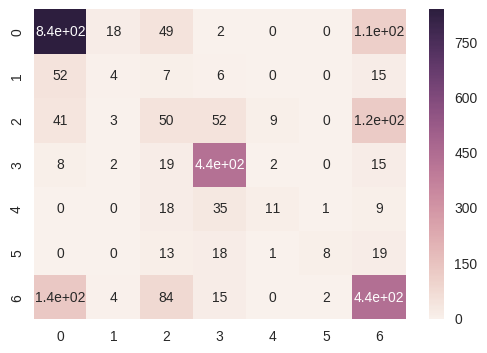

In [16]:
from sklearn.metrics import confusion_matrix

# Compute confusion matrix
cnf_matrix = confusion_matrix(all_y['c0'], predicted)
np.set_printoptions(precision=2)

df_cm = pd.DataFrame(cnf_matrix, index = [str(x) for x in range(0, CLASS_NUM)],
                  columns = [str(x) for x in range(0, CLASS_NUM)])
sns.heatmap(df_cm, annot=True)

## 对测试集合预测的混淆矩阵

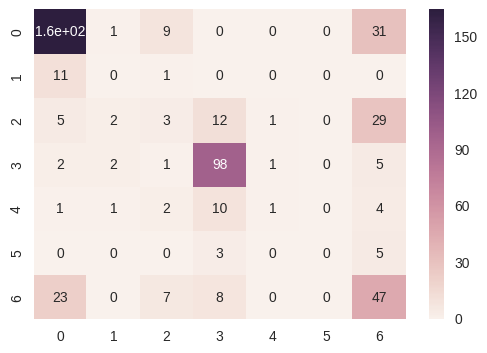

In [17]:
from sklearn.metrics import confusion_matrix

# Compute confusion matrix
cnf_matrix = confusion_matrix(test_y, pred)
np.set_printoptions(precision=2)

df_cm = pd.DataFrame(cnf_matrix, index = [str(x) for x in range(0, CLASS_NUM)],
                  columns = [str(x) for x in range(0, CLASS_NUM)])
sns.heatmap(df_cm, annot=True)

## 使用从训练集建立的模型，标注测试集合的每一个数据点（第三子任务）

In [18]:
def smooth_labels(labels):
    """
    人工平滑Labels，如果某段label的长度小于800，则使用前一个label覆盖
    """
    label_last = labels[0]
    label_previous = labels[0]
    the_counter = 0
    for i in range(len(labels)):
        if label_previous == labels[i]:
            the_counter += 1
            continue
        
        if the_counter < 800:
            labels[i-the_counter:i] = label_last
            label_previous = label_last
        the_counter = 1
        label_last = label_previous
        label_previous = labels[i]

In [19]:
def mark_bit(dataset, model):
    """
    使用分类器model，标注dataset中的每一个数据点
    
    BIN_N指明了使用的采样数量，即对SEQ_N // BIN_N个点
    取前后共9次预测的label的概率最大值为label
    """
    labels = np.zeros(dataset.shape[0])
    activity_feature = []
    activity_position = []
    BIN_N = 9
    step = SEQ_N // BIN_N
    for start in range(0, len(dataset), step):
        end = len(dataset)
        if start + SEQ_N < len(dataset):
            end = start + SEQ_N
        else:
            start = len(dataset) - SEQ_N
        
        seq = dataset.iloc[start:end]
        
        features = extract_raw_info(seq)
        ff = extract_fft_info(seq)
        features = features + minmax_scale(ff).tolist()
        
        activity_feature.append(features)
        activity_position.append((start, end))
    
    the_X = pd.DataFrame(activity_feature)
    the_y_proba = model.predict_proba(the_X)
    
    history_class_proba = np.array([np.zeros(CLASS_NUM) for i in range(BIN_N)])
    
    the_counter = 0
    label_cur = 0
    label_last = 0
    for pos, class_proba in zip(activity_position, the_y_proba):
        history_class_proba = history_class_proba + class_proba
        label_cur = np.argmax(history_class_proba[0])
        labels[pos[0]:pos[1]] = label_cur
        
        history_class_proba[0] = 0
        history_class_proba = np.roll(history_class_proba, -1, axis=0)
    
    return labels

def validate_bit(dataset, labels):
    """
    验证每个label与实时相比的正确率
    """
    return np.sum(dataset['label'].as_matrix() == (labels+1) ) / float(dataset.shape[0])

## 对所有数据集进行标注，其中最重要看后三个数据集的标注结果

In [20]:
# import time
# time_start = time.time()
# for x in range(0, len(datasets)):
#     print('数据集：', x, '维度', datasets[x].shape)
#     labels = mark_bit(datasets[x], model)
#     smooth_labels(labels)
#     print('逐点准确度 =', validate_bit(datasets[x], labels))

# print('耗时:', time.time() - time_start)

# 画图函数

In [21]:
def plot_dataset(dataset):
    """
    将数据集的xyz信号随着时间线画出曲线图
    """
    trace0 = go.Scatter(x=dataset['time'], y=dataset['x'])
    trace1 = go.Scatter(x=dataset['time'], y=dataset['y'])
    trace2 = go.Scatter(x=dataset['time'], y=dataset['z'])
    data = Data([trace0, trace1, trace2])
    py.offline.iplot(data)

def plot_label(dataset, label_column):
    """
    将数据集的label随着时间线画出曲线图
    """
    dummy_label = pd.get_dummies(label_column)
    label_data = []
    for i in range(1, 8):
        if i not in dummy_label.columns:
            label_data.append(go.Scatter(x=dataset['time'], y=np.zeros(dataset['time'].shape[0])))
        else:
            label_data.append(go.Scatter(x=dataset['time'], y=dummy_label[i]))
    py.offline.iplot(label_data)

def plot_2(dataset):
    """
    将数据集的标注的label和实时label画图对比
    """
    plot_label(dataset, dataset['label'])
    labels = mark_bit(dataset, model)+1
    plot_label(dataset, pd.DataFrame(labels)[0])
    smooth_labels(labels)
    plot_label(dataset, pd.DataFrame(labels)[0])

In [22]:
datasets[0]['x']

0         0.786111
1         0.872468
2         0.843159
3         0.837926
4         0.859907
5         0.839496
6         0.858337
7         0.841066
8         0.809140
9         0.800242
10        0.856767
11        0.835309
12        0.832168
13        0.837926
14        0.807046
15        0.836355
16        0.790822
17        0.813850
18        0.789252
19        0.826935
20        0.851533
21        0.833215
22        0.855197
23        0.857291
24        0.833739
25        0.807046
26        0.837926
27        0.844206
28        0.860431
29        0.859384
            ...   
162471    1.006453
162472    1.008023
162473    1.006976
162474    1.006453
162475    1.005406
162476    1.006976
162477    1.007500
162478    1.011163
162479    1.006976
162480    1.010116
162481    1.010640
162482    1.010116
162483    1.006976
162484    1.009070
162485    1.010116
162486    1.009593
162487    1.009070
162488    1.007500
162489    1.010640
162490    1.010640
162491    1.008546
162492    1.

In [34]:
def fff(dataset):
    dd = dataset.copy(deep=True)
    for ax in 'xyz':
        dd[ax] = butter_lowpass_filter(dd[ax], 6, fs, order)
    return dd

In [35]:
# 第14个数据集的标注结果
plot_dataset(datasets[0])
plot_dataset(fff(datasets[0]))

# plot_2(datasets[7])

In [25]:
# # 第15个数据集的标注结果
# plot_dataset(datasets[14])
# plot_2(datasets[14])